# Settings

In [ ]:
import sys
is_colab = False
if "google.colab" in sys.modules:
  is_colab = True

In [ ]:
if is_colab:
    from google.colab import drive
    drive.mount('/content/drive')

In [ ]:
SEED = 2022 #43 #毎回同じ結果になるようにランダムシードを固定
HOME_DIR = './' #画像の置いたフォルダ
CAM_NUM = 9 #9 max 9 cameras
NUM_WORKERS = 0
if is_colab:
    HOME_DIR = '/content/drive/MyDrive/kaggle/WG/' #画像の置いたフォルダ
    NUM_WORKERS = 2

# SegFormer Train

In [ ]:
!nvidia-smi

Fri Nov 18 20:05:28 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 517.00       Driver Version: 517.00       CUDA Version: 11.7     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:01:00.0  On |                  N/A |
| N/A   53C    P8    16W /  N/A |   3773MiB /  6144MiB |     16%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
#%%capture
!pip install opencv-python
!pip install tqdm
!pip install matplotlib

In [ ]:
!blender --version

Blender 3.3.0
	build date: 2022-09-07
	build time: 00:44:18
	build commit date: 2022-09-06
	build commit time: 15:39
	build hash: 0759f671ce1f
	build platform: Windows
	build type: release
	build c flags: /W3 /w34062 /w34115 /w34189 /wd4018 /wd4146 /wd4065 /wd4127 /wd4181 /wd4200 /wd4244 /wd4267 /wd4305 /wd4800 /wd4828 /wd4996 /wd4661 /wd4848 /we4013 /we4133 /we4431 /w35038 /DWIN32 /D_WINDOWS /W3 /nologo /J /Gd /MP /bigobj /Zc:inline -openmp   
	build c++ flags: /W3 /w34062 /w34115 /w34189 /wd4018 /wd4146 /wd4065 /wd4127 /wd4181 /wd4200 /wd4244 /wd4267 /wd4305 /wd4800 /wd4828 /wd4996 /wd4661 /wd4848 /we4013 /we4133 /we4431 /w35038 /DWIN32 /D_WINDOWS /W3  /EHsc /nologo /J /Gd /MP /EHsc /bigobj /Zc:inline /permissive- /Zc:twoPhase- -openmp /Zc:__cplusplus   
	build link flags: /MACHINE:X64  /SUBSYSTEM:CONSOLE /STACK:2097152 /ignore:4049 /ignore:4217 /ignore:4221
	build system: CMake


In [ ]:
!echo  BLENDER_EEVEE CYCLES
FRAME_MABIKI=6
!echo $FRAME_MABIKI
#!blender.exe --background -noaudio loblaw_jissun_movieD.blend -E BLENDER_EEVEE --frame-jump $FRAME_MABIKI --python render_script.py --log-level 0 --log-show-timestamp --log-file render.log >>render_err.txt 2>&1
!blender.exe --background -noaudio loblaw_jissun_movieNEW.blend -E BLENDER_EEVEE --log-show-timestamp --log-file render.log  --python render_script_longMovie.py>render_err.txt 2>&1

 BLENDER_EEVEE CYCLES
6


## kaggle

In [ ]:
!pip install matplotlib

In [ ]:
HOME_DIR = './'

In [ ]:
import os
import numpy as np
import cv2

from tqdm.notebook import tqdm

In [ ]:
import matplotlib.pyplot as plt

  0%|          | 0/9 [00:00<?, ?it/s]

./Camera.001/rendering_data_long/images\image00054.png
./Camera.001/rendering_data_long/images\image00114.png
./Camera.001/rendering_data_long/images\image00174.png
./Camera.001/rendering_data_long/images\image00234.png
./Camera.001/rendering_data_long/images\image00294.png
./Camera.001/rendering_data_long/images\image00354.png
./Camera.001/rendering_data_long/images\image00414.png
./Camera.001/rendering_data_long/images\image00474.png
./Camera.001/rendering_data_long/images\image00534.png
./Camera.001/rendering_data_long/images\image00594.png
./Camera.001/rendering_data_long/images\image00654.png
./Camera.001/rendering_data_long/images\image00714.png
./Camera.001/rendering_data_long/images\image00774.png
./Camera.001/rendering_data_long/images\image00834.png
./Camera.001/rendering_data_long/images\image00894.png
./Camera.001/rendering_data_long/images\image00954.png
./Camera.001/rendering_data_long/images\image01014.png
./Camera.001/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.002/rendering_data_long/images\image00054.png
./Camera.002/rendering_data_long/images\image00114.png
./Camera.002/rendering_data_long/images\image00174.png
./Camera.002/rendering_data_long/images\image00234.png
./Camera.002/rendering_data_long/images\image00294.png
./Camera.002/rendering_data_long/images\image00354.png
./Camera.002/rendering_data_long/images\image00414.png
./Camera.002/rendering_data_long/images\image00474.png
./Camera.002/rendering_data_long/images\image00534.png
./Camera.002/rendering_data_long/images\image00594.png
./Camera.002/rendering_data_long/images\image00654.png
./Camera.002/rendering_data_long/images\image00714.png
./Camera.002/rendering_data_long/images\image00774.png
./Camera.002/rendering_data_long/images\image00834.png
./Camera.002/rendering_data_long/images\image00894.png
./Camera.002/rendering_data_long/images\image00954.png
./Camera.002/rendering_data_long/images\image01014.png
./Camera.002/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.003/rendering_data_long/images\image00054.png
./Camera.003/rendering_data_long/images\image00114.png
./Camera.003/rendering_data_long/images\image00174.png
./Camera.003/rendering_data_long/images\image00234.png
./Camera.003/rendering_data_long/images\image00294.png
./Camera.003/rendering_data_long/images\image00354.png
./Camera.003/rendering_data_long/images\image00414.png
./Camera.003/rendering_data_long/images\image00474.png
./Camera.003/rendering_data_long/images\image00534.png
./Camera.003/rendering_data_long/images\image00594.png
./Camera.003/rendering_data_long/images\image00654.png
./Camera.003/rendering_data_long/images\image00714.png
./Camera.003/rendering_data_long/images\image00774.png
./Camera.003/rendering_data_long/images\image00834.png
./Camera.003/rendering_data_long/images\image00894.png
./Camera.003/rendering_data_long/images\image00954.png
./Camera.003/rendering_data_long/images\image01014.png
./Camera.003/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.004/rendering_data_long/images\image00054.png
./Camera.004/rendering_data_long/images\image00114.png
./Camera.004/rendering_data_long/images\image00174.png
./Camera.004/rendering_data_long/images\image00234.png
./Camera.004/rendering_data_long/images\image00294.png
./Camera.004/rendering_data_long/images\image00354.png
./Camera.004/rendering_data_long/images\image00414.png
./Camera.004/rendering_data_long/images\image00474.png
./Camera.004/rendering_data_long/images\image00534.png
./Camera.004/rendering_data_long/images\image00594.png
./Camera.004/rendering_data_long/images\image00654.png
./Camera.004/rendering_data_long/images\image00714.png
./Camera.004/rendering_data_long/images\image00774.png
./Camera.004/rendering_data_long/images\image00834.png
./Camera.004/rendering_data_long/images\image00894.png
./Camera.004/rendering_data_long/images\image00954.png
./Camera.004/rendering_data_long/images\image01014.png
./Camera.004/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.005/rendering_data_long/images\image00054.png
./Camera.005/rendering_data_long/images\image00114.png
./Camera.005/rendering_data_long/images\image00174.png
./Camera.005/rendering_data_long/images\image00234.png
./Camera.005/rendering_data_long/images\image00294.png
./Camera.005/rendering_data_long/images\image00354.png
./Camera.005/rendering_data_long/images\image00414.png
./Camera.005/rendering_data_long/images\image00474.png
./Camera.005/rendering_data_long/images\image00534.png
./Camera.005/rendering_data_long/images\image00594.png
./Camera.005/rendering_data_long/images\image00654.png
./Camera.005/rendering_data_long/images\image00714.png
./Camera.005/rendering_data_long/images\image00774.png
./Camera.005/rendering_data_long/images\image00834.png
./Camera.005/rendering_data_long/images\image00894.png
./Camera.005/rendering_data_long/images\image00954.png
./Camera.005/rendering_data_long/images\image01014.png
./Camera.005/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.006/rendering_data_long/images\image00054.png
./Camera.006/rendering_data_long/images\image00114.png
./Camera.006/rendering_data_long/images\image00174.png
./Camera.006/rendering_data_long/images\image00234.png
./Camera.006/rendering_data_long/images\image00294.png
./Camera.006/rendering_data_long/images\image00354.png
./Camera.006/rendering_data_long/images\image00414.png
./Camera.006/rendering_data_long/images\image00474.png
./Camera.006/rendering_data_long/images\image00534.png
./Camera.006/rendering_data_long/images\image00594.png
./Camera.006/rendering_data_long/images\image00654.png
./Camera.006/rendering_data_long/images\image00714.png
./Camera.006/rendering_data_long/images\image00774.png
./Camera.006/rendering_data_long/images\image00834.png
./Camera.006/rendering_data_long/images\image00894.png
./Camera.006/rendering_data_long/images\image00954.png
./Camera.006/rendering_data_long/images\image01014.png
./Camera.006/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.007/rendering_data_long/images\image00054.png
./Camera.007/rendering_data_long/images\image00114.png
./Camera.007/rendering_data_long/images\image00174.png
./Camera.007/rendering_data_long/images\image00234.png
./Camera.007/rendering_data_long/images\image00294.png
./Camera.007/rendering_data_long/images\image00354.png
./Camera.007/rendering_data_long/images\image00414.png
./Camera.007/rendering_data_long/images\image00474.png
./Camera.007/rendering_data_long/images\image00534.png
./Camera.007/rendering_data_long/images\image00594.png
./Camera.007/rendering_data_long/images\image00654.png
./Camera.007/rendering_data_long/images\image00714.png
./Camera.007/rendering_data_long/images\image00774.png
./Camera.007/rendering_data_long/images\image00834.png
./Camera.007/rendering_data_long/images\image00894.png
./Camera.007/rendering_data_long/images\image00954.png
./Camera.007/rendering_data_long/images\image01014.png
./Camera.007/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.008/rendering_data_long/images\image00054.png
./Camera.008/rendering_data_long/images\image00114.png
./Camera.008/rendering_data_long/images\image00174.png
./Camera.008/rendering_data_long/images\image00234.png
./Camera.008/rendering_data_long/images\image00294.png
./Camera.008/rendering_data_long/images\image00354.png
./Camera.008/rendering_data_long/images\image00414.png
./Camera.008/rendering_data_long/images\image00474.png
./Camera.008/rendering_data_long/images\image00534.png
./Camera.008/rendering_data_long/images\image00594.png
./Camera.008/rendering_data_long/images\image00654.png
./Camera.008/rendering_data_long/images\image00714.png
./Camera.008/rendering_data_long/images\image00774.png
./Camera.008/rendering_data_long/images\image00834.png
./Camera.008/rendering_data_long/images\image00894.png
./Camera.008/rendering_data_long/images\image00954.png
./Camera.008/rendering_data_long/images\image01014.png
./Camera.008/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

./Camera.009/rendering_data_long/images\image00054.png
./Camera.009/rendering_data_long/images\image00114.png
./Camera.009/rendering_data_long/images\image00174.png
./Camera.009/rendering_data_long/images\image00234.png
./Camera.009/rendering_data_long/images\image00294.png
./Camera.009/rendering_data_long/images\image00354.png
./Camera.009/rendering_data_long/images\image00414.png
./Camera.009/rendering_data_long/images\image00474.png
./Camera.009/rendering_data_long/images\image00534.png
./Camera.009/rendering_data_long/images\image00594.png
./Camera.009/rendering_data_long/images\image00654.png
./Camera.009/rendering_data_long/images\image00714.png
./Camera.009/rendering_data_long/images\image00774.png
./Camera.009/rendering_data_long/images\image00834.png
./Camera.009/rendering_data_long/images\image00894.png
./Camera.009/rendering_data_long/images\image00954.png
./Camera.009/rendering_data_long/images\image01014.png
./Camera.009/rendering_data_long/images\image01074.png
./Camera.0

ffmpeg version 5.1.2-full_build-www.gyan.dev Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.1.0 (Rev2, Built by MSYS2 project)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-w32threads --disable-autodetect --enable-fontconfig --enable-iconv --enable-gnutls --enable-libxml2 --enable-gmp --enable-bzlib --enable-lzma --enable-libsnappy --enable-zlib --enable-librist --enable-libsrt --enable-libssh --enable-libzmq --enable-avisynth --enable-libbluray --enable-libcaca --enable-sdl2 --enable-libaribb24 --enable-libdav1d --enable-libdavs2 --enable-libuavs3d --enable-libzvbi --enable-librav1e --enable-libsvtav1 --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxavs2 --enable-libxvid --enable-libaom --enable-libjxl --enable-libopenjpeg --enable-libvpx --enable-mediafoundation --enable-libass --enable-frei0r --enable-libfreetype --enable-libfribidi --enable-liblensfun --enable-libvidstab --enable-libvmaf --enable-libzimg --enable-amf --e

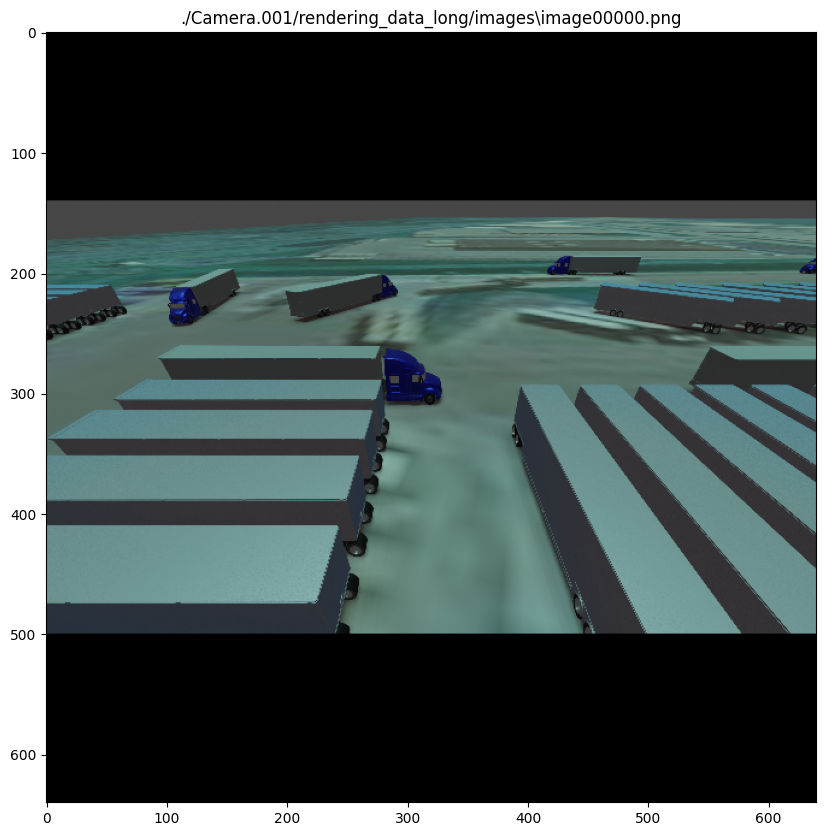

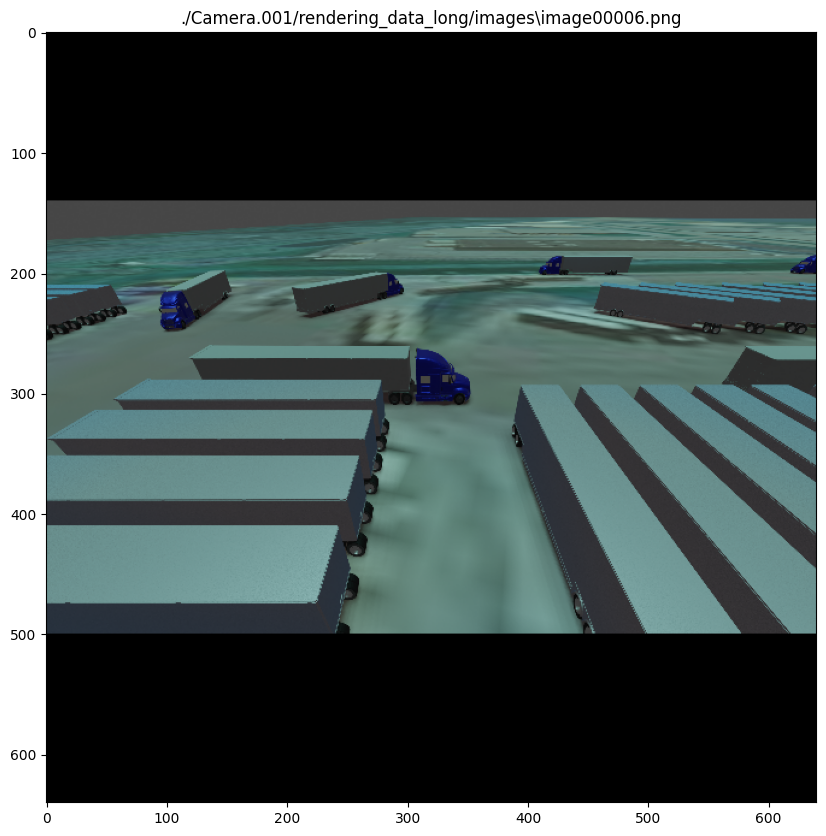

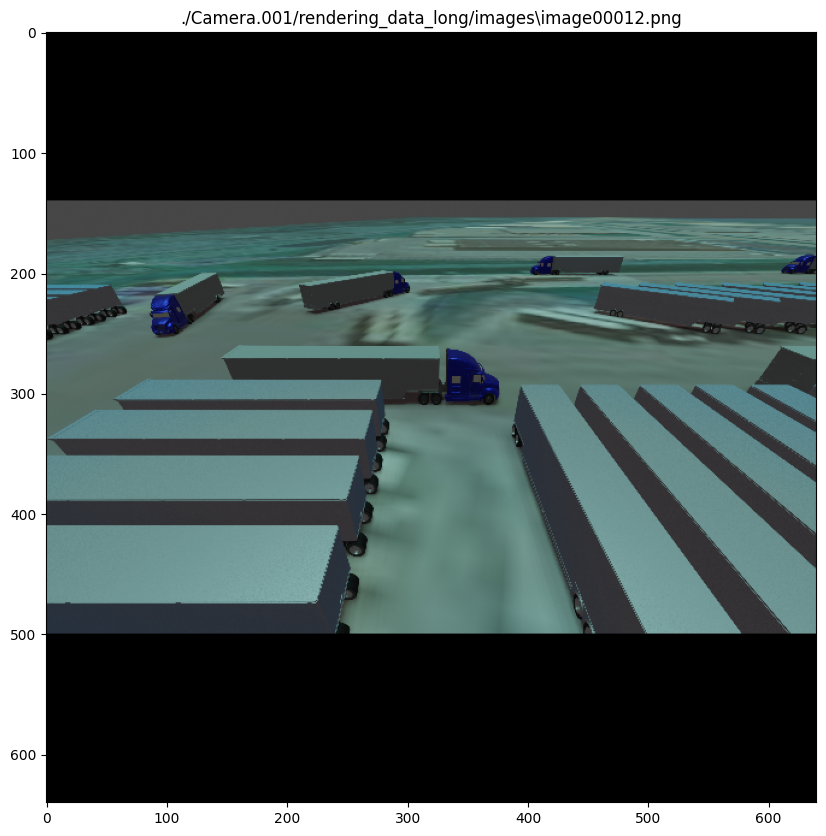

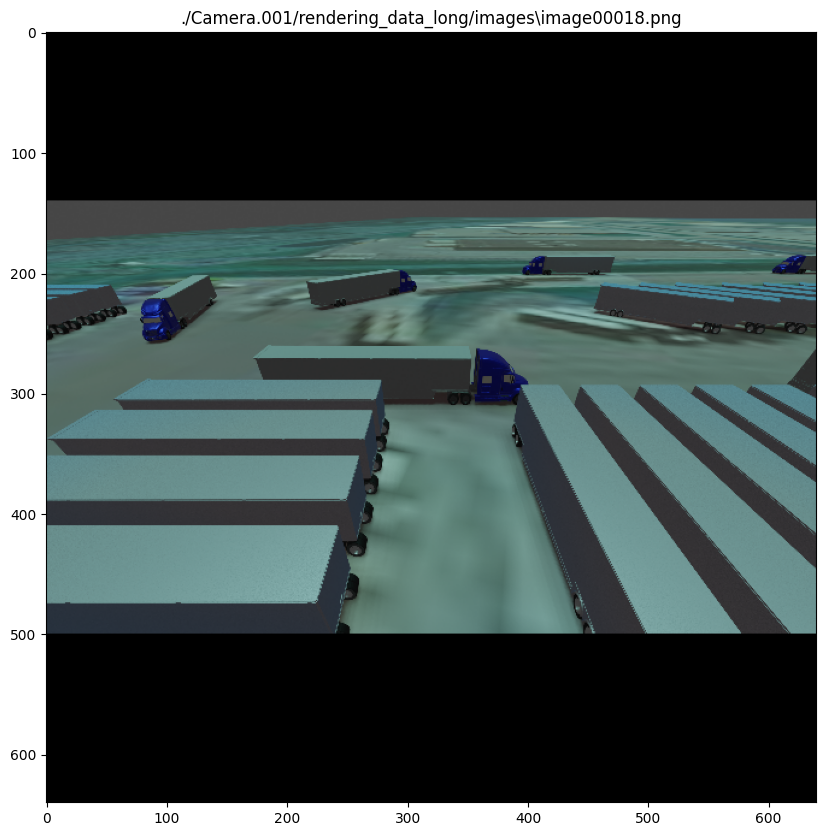

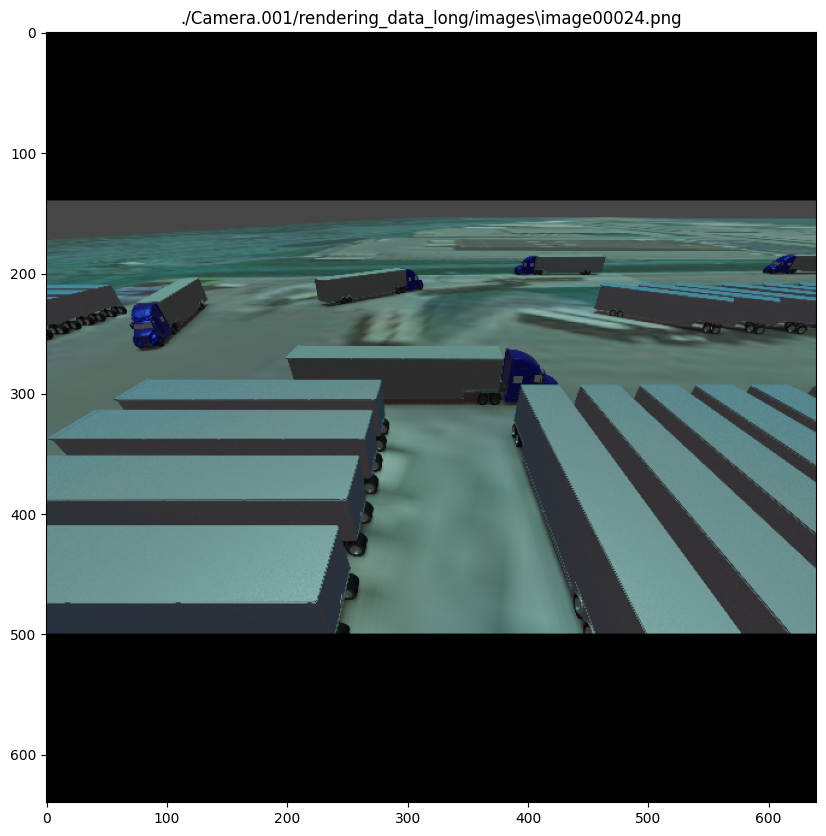

...

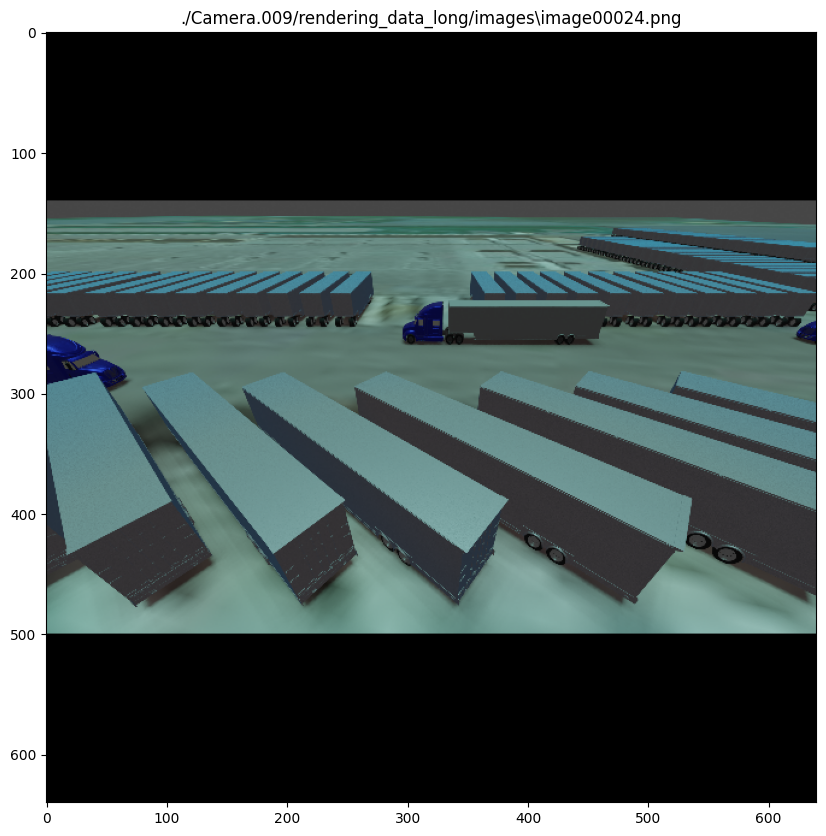

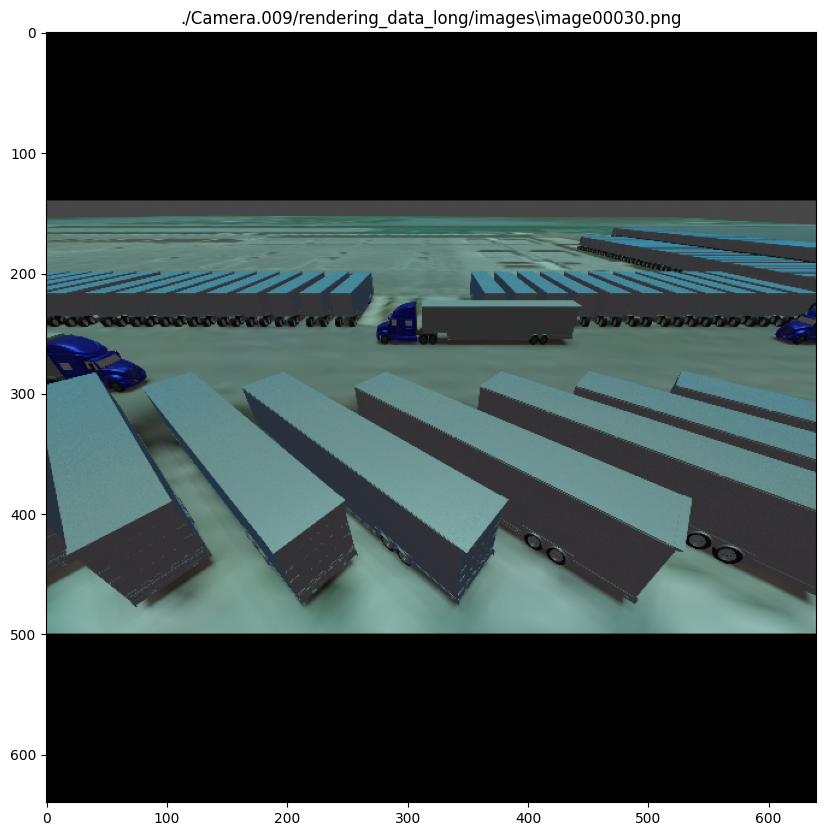

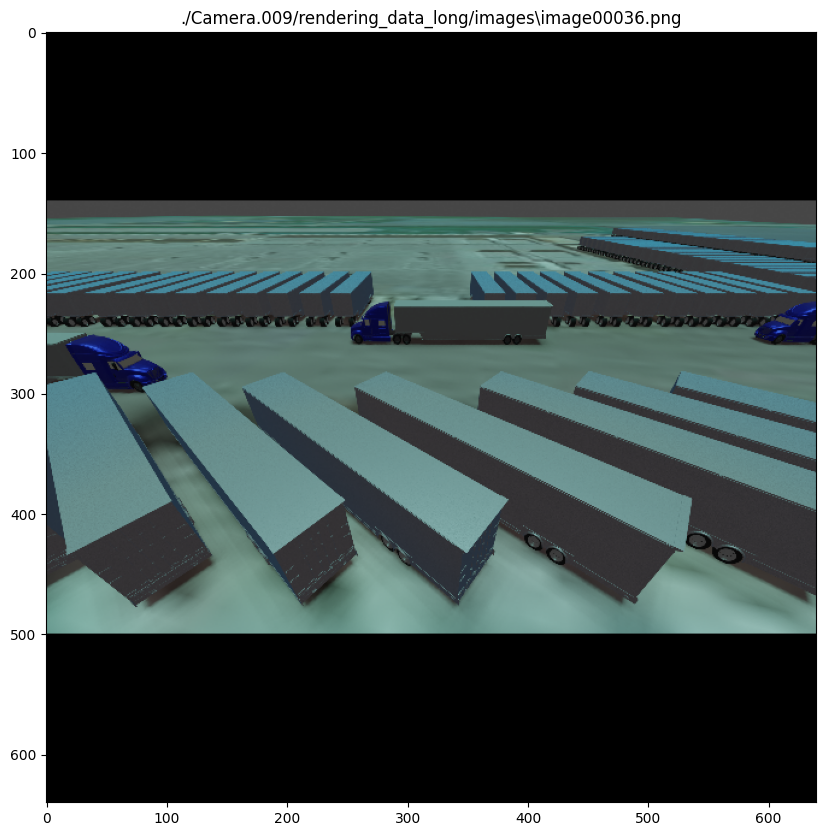

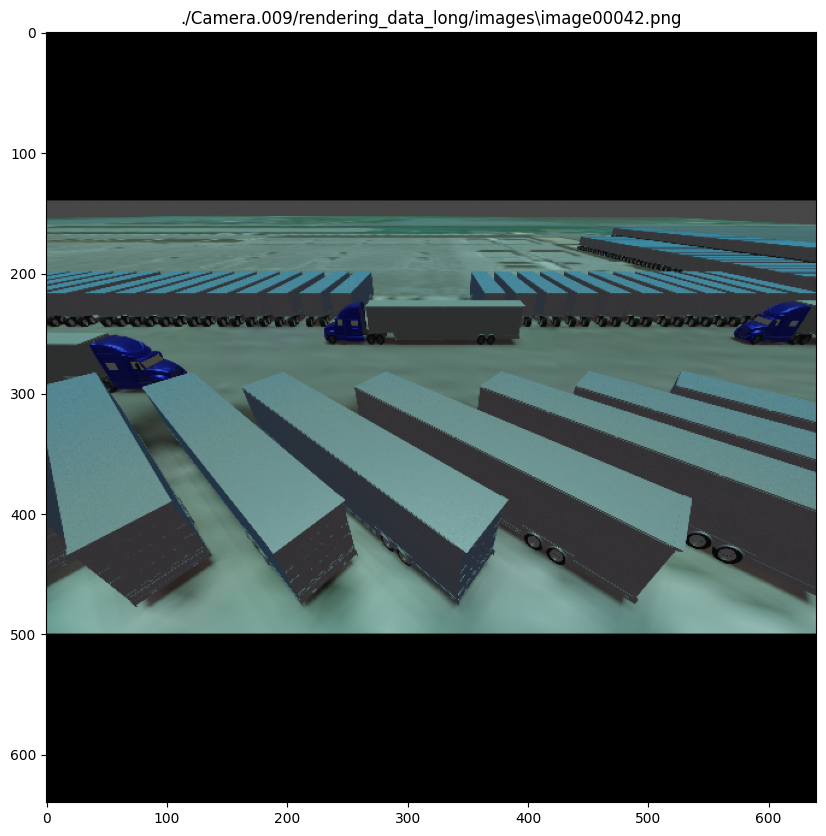

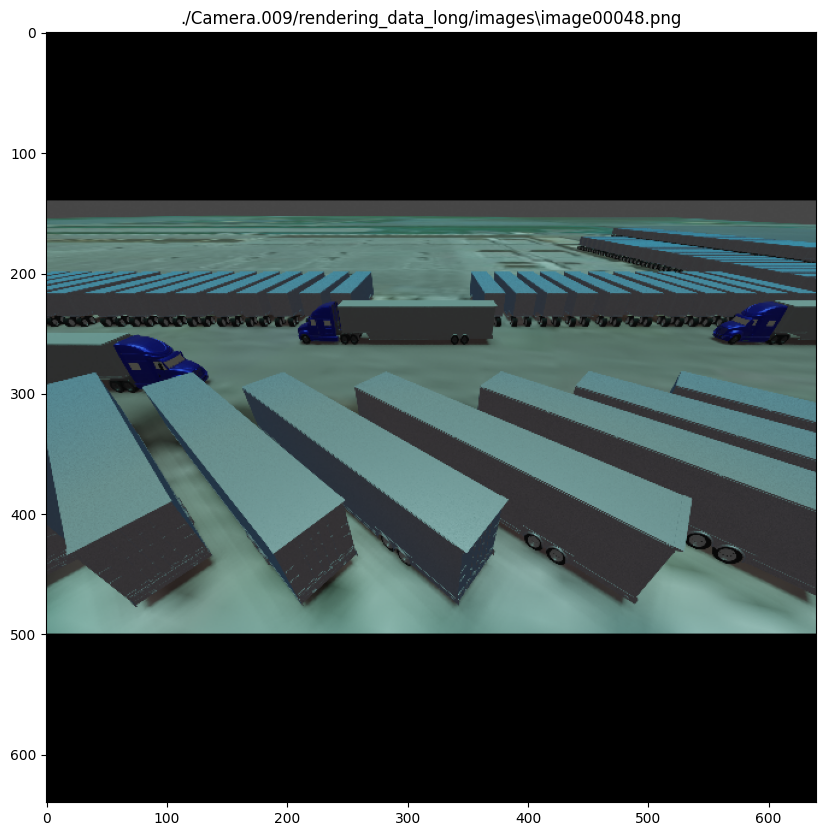

In [ ]:
import glob
for cam_id in tqdm(range(CAM_NUM)):
    CAM_NAME = f'Camera.{(cam_id+1):03d}'
    IMAGE_DIR = HOME_DIR + CAM_NAME + '/rendering_data_long/images/'
    ANNOT_DIR = HOME_DIR + CAM_NAME + '/rendering_data_long/labels/'

    MURA_IMAGE_DIR = IMAGE_DIR
    mura_files = MURA_IMAGE_DIR + '*.png'
    mura_list = glob.glob(mura_files)
    mura_img_vga = []
    render_h, render_w = 360, 640
    dest_h, dest_w,dest_fps = 640, 640,5.0
    #dest_h, dest_w = 942, 1254
    #dest_h, dest_w = 480, 640
    #dest_h, dest_w = HEIGHT, WIDTH
    vga_img = np.zeros((dest_h, dest_w, 3), dtype=np.uint8)
    #fourcc = cv2.VideoWriter_fourcc(*'MP4V')
    fourcc = cv2.VideoWriter_fourcc(*'H264')
    video_path = HOME_DIR + CAM_NAME + f'/camera{(cam_id+1):03d}_long.mp4'
    out_video = cv2.VideoWriter(video_path, fourcc, dest_fps, (dest_w,dest_h))

    cnt = 0
    N_LOOP = 1#int(3000/len(mura_list) + 1)
    for x in range(N_LOOP):
        for fpath in mura_list:    
            imgz = cv2.imread(fpath, cv2.IMREAD_COLOR)
            #img_rgbz = cv2.cvtColor(imgz, cv2.COLOR_BGR2RGB)
            #img_rsz = cv2.resize(img_rgbz, (dest_w, dest_h))
            #mura_img_vga.append(img_rsz)
            img_rsz = cv2.resize(imgz, (render_w, render_h),cv2.INTER_AREA)
            img_h, img_w, _ = img_rsz.shape
            starth = (dest_h - img_h)//2
            startw = (dest_w - img_w)//2
            vga_img[starth:starth+img_h, startw:startw +img_w] = img_rsz
            out_video.write(vga_img)    
            cnt += 1
            if cnt < 10:        
                plt.figure(figsize=(20,10))
                plt.title(fpath)
                plt.imshow(vga_img)
            elif cnt % 10 == 0:
                print(fpath)
    out_video.release()
    #mura_blend_func = albu.TemplateTransform (templates=mura_img_vga, img_weight=0.8, template_weight=0.2, p=1.0)
    print(f'done writing {cnt} images to {video_path}!\n---------------------\n')
    cvt_path = video_path[:-4] + 'h264.mp4'
    !ffmpeg -y -i $video_path -vcodec libx264 -q:v 1 $cvt_path

In [ ]:
import glob
for cam_id in tqdm(range(CAM_NUM)):
    CAM_NAME = f'Camera.{(cam_id+1):03d}'
    #IMAGE_DIR = HOME_DIR + CAM_NAME + '/rendering_data_long/images/'
    ANNOT_DIR = HOME_DIR + CAM_NAME + '/rendering_data_long/labels/'
    MURA_ANNOT_DIR = ANNOT_DIR
    mura_files = MURA_ANNOT_DIR + 'image*.txt'
    mura_list = glob.glob(mura_files)
    render_h, render_w = 360, 640
    dest_h, dest_w,dest_fps = 640, 640,5.0
    cnt = 0
    json_path = HOME_DIR + CAM_NAME + f'/camera{(cam_id+1):03d}_longh264.json'
    print(json_path)
    lenx = len(mura_list)
    print(f'total {lenx} frames')
    with open(json_path, 'w') as json_file:
        json_file.write('[\n')        
        has_prev_frame = False
        new_flg = 'true'
        new_auto_flg = 'false'
        overlap_flg = 'false'
        N_LOOP = 1#int(3000/len(mura_list) + 1)
        for x in range(N_LOOP):
            for fpath in mura_list:    
                with open(fpath, 'r') as f_annot:
                    if has_prev_frame: json_file.write(',\n')
                    json_file.write('\t[')
                    has_before = False
                    while True:
                        line = f_annot.readline()
                        if not line:
                            break
                        class_id, cx, cy, ww, hh = map(float, line.split())
                        json_classid = int(class_id + 0.1)
                        json_cx = cx*render_w + (dest_w - render_w)*0.5
                        json_cy = cy*render_h + (dest_h - render_h)*0.5
                        json_w = ww*render_w
                        json_h = hh*render_h
                        json_lx = json_cx - json_w*0.5
                        json_ly = json_cy - json_h*0.5
                        # json出力       
                        json_prev_end = '\n'
                        if has_before: json_prev_end = ',\n'
                        json_file.write(json_prev_end)
                        json_row = '\t{\n\t\t' + '"class": {},\n\t\t"x": {},\n\t\t"y": {},\n\t\t"w": ' \
                                '{},\n\t\t"h": {},\n\t\t"new": {},\n\t\t"new_auto": {},' \
                                '\n\t\t"overlap": {}'.format(json_classid, json_lx, json_ly, json_w, json_h, new_flg, new_auto_flg, overlap_flg) + '\n\t}'
                        json_file.write(json_row)       
                        has_before = True
                    json_file.write('\n\t]')
                    has_prev_frame = True
                    json_file.flush()
        # close json
        json_file.write('\n]\n')

  0%|          | 0/9 [00:00<?, ?it/s]

./Camera.001/camera001_longh264.json
total 334 frames
./Camera.002/camera002_longh264.json
total 334 frames
./Camera.003/camera003_longh264.json
total 334 frames
./Camera.004/camera004_longh264.json
total 334 frames
./Camera.005/camera005_longh264.json
total 334 frames
./Camera.006/camera006_longh264.json
total 334 frames
./Camera.007/camera007_longh264.json
total 334 frames
./Camera.008/camera008_longh264.json
total 334 frames
./Camera.009/camera009_longh264.json
total 334 frames


In [ ]:
# import gc
# try:    
#     model.cpu()
#     del model
# except NameError: model = None
# try:    
#     model2.cpu()
#     del model2
# except NameError: model2 = None
# gc.collect()
# torch.cuda.empty_cache()
# !nvidia-smi